In [3]:
import pymysql
import pandas.io.sql as psql

import pandas as pd
import numpy as np
import statsmodels.api as sm
from scipy.stats import chisqprob
# import re

import pickle
import pprint as pp

from sklearn.preprocessing import Imputer

# from matplotlib.colors import ListedColormap
# from sklearn.cross_validation import train_test_split
# from sklearn.preprocessing import StandardScaler
# from sklearn.datasets import make_moons, make_circles, make_classification

from sklearn.linear_model import LogisticRegression

from sklearn.cross_validation import cross_val_score
from sklearn.metrics import accuracy_score

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [1]:
""" REMOVE identifying information"""

' REMOVE identifying information'

In [4]:
"""connect to TestStress"""

def connect():
    """Function to connect to the database"""

    db = pymysql.connect(host=host,
                         user=user,
                         passwd=passwd,
                         db='framingham')
    return db


def import_df(sql_table):
    """Import dataframe from MySql, returns a pandas dataframe"""

    db = connect()
    sql = "SELECT * FROM %s" % sql_table
    df = psql.read_sql(sql, db)
    db.close()

    return df

def fix_sex(sex):
    if sex == 2:
        return 0
    else:
        return sex
    
def gender(sex):
    if sex:
        return 'male'
    else:
        return 'female'

def fill_holes(dataframe, catagorical, continuous, stratagey ='mean'):
   """takes a data frame where the missing values are nans a list of the columns that are catagorical
   and a list of the columns that continuous variables. relplaces the holes in the continuous
   variables either the mean or the median and replaces the catagorical variables with the mode"""
   imean = Imputer(copy=False, axis=1)
   imode = Imputer(strategy='most_frequent', copy=False, axis=1)
   imedian =Imputer(strategy='median', copy=False, axis=1)
   if stratagey == 'mean':
       continuous_imputer = imean
   else:
       continuous_imputer =  imedian
   catagorical_imputer = imode
   
   for col in catagorical:
       catagorical_imputer.fit_transform(dataframe[col])
   for col in continuous:
       continuous_imputer.fit_transform(dataframe[col])

def count_missing(frame):
    return (frame.shape[0] * frame.shape[1]) - frame.count().sum()                    

                    
def clean_data(df, categorical_list, continuous_list, int_list, drop=False):
    # replace NaN
    df[int_list] = df[int_list].astype(int)
    df[['randid', 'period']] = df[['randid', 'period']].astype(int)
    df['sex'] = df['sex'].apply(lambda x: fix_sex(x))
    df['gender'] = df['sex'].apply(lambda x: gender(x))
    if drop:
        df = df.dropna()
    else:
        print 'filling holes'
#         df.groupby('randid').apply(count_missing)
        fill_holes(df, categorical_list, continuous_list)
    
    return df

def add_dummies(df, dummies_list, additional_cat=None):
    """ Adds dummies for catergorical features"""
    for col in dummies_list:
#         print col
        df = pd.concat([df, pd.get_dummies(df[col], prefix=col)], axis=1)
    if additional_cat:
        df = pd.concat([df, pd.get_dummies(df[additional_cat], prefix=additional_cat)], axis=1)
        
    return df


if __name__ == '__main__':

    categorical_list = ['sex', 'randid', 'cursmoke', 'diabetes', 'bpmeds',
                        'prevchd', 'prevap', 'prevmi', 'prestrk', 'prevhyp',
                        'period', 'death', 'angina', 'hospmi', 
                        'mi_fchd', 'anychd', 'stroke', 'cvd', 'hyperten']
    diagnosis_list = ['death', 'angina', 'hospmi', 'mi_fchd', 'anychd', 
                      'stroke', 'cvd', 'hyperten']
    continuous_list = ['totchol', 'age', 'sysbp', 'diabp', 'cigpday', 'bmi',
                       'heartrte', 'glucose', 'time', 
                       'timeap', 'timemi', 'timemifc', 'timechd', 'timestrk',
                       'timecvd', 'timedth', 'timehyp']
    dummies_list = ['period']
    new_chol_data = ['hdlc', 'ldlc' ]
    
    plot_dropna_df = clean_data(import_df('framingham_data'),
                                categorical_list,
                                continuous_list,
                                diagnosis_list,
                                drop=True)
    
    plot_df = clean_data(import_df('framingham_data'), 
                         categorical_list,
                         continuous_list,
                         diagnosis_list)

    df = import_df('framingham_data')
    impute_without_chol_spilt_df = add_dummies(clean_data(df.drop(new_chol_data,
                                                                  axis=1).copy(),
                                                          categorical_list,
                                                          continuous_list,
                                                          diagnosis_list),
                                               dummies_list)
#     print diagnosis_list
#     print without_chol_spilt_df.columns
    dropna_without_chol_split_df = add_dummies(clean_data(df.drop(new_chol_data,
                                                                  axis=1).copy(),
                                                          categorical_list,
                                                          continuous_list,
                                                          diagnosis_list,
                                                          drop=True),
                                               dummies_list)


    
    df['year'] = (df['time']/365).astype(int)

#     df = add_dummies(df, dummies_list)

#     print 'Type of the dataframe', type(df)
#     print 'Length of the dataframe:', len(df)
#     print 'Length of the dataframe:', len(drop_diff_chol_df)
#     print 'Length of the no split chol dropna dataframe:', len(drop_no_chol_na_df)


filling holes
filling holes


In [6]:
# without_chol_spilt_df.head()
# dropna_without_chol_split_df.head()

In [7]:
print categorical_list[2:5]

['cursmoke', 'diabetes', 'bpmeds']


## Preprocessing 
###- for each EVENT, discount records for respondent after EVENT occurs (ie encountered in eval period)

In [41]:
# test_df = df.copy()
# test_df = drop_na_df.copy()
# test_df = drop_na_df.head()

# test_df = without_chol_spilt_df.copy()
test_df = dropna_without_chol_split_df.copy()
# set(test_df.randid.astype(int))

In [42]:
def preprocessing(df, yvar):
    
#     print df[['randid','period', yvar]]
    for index, row in df.iterrows():
        if index == 0:
            patient = df.randid[index]
            period = df.period[index]
            event = df[yvar][index]
        else:
            new_id = df.randid[index]
            new_period = df.period[index]
            new_event = df[yvar][index]
            if new_id == patient:
                if event:
#                     print patient , period , 'drop b/c event'
                    df.drop([index],inplace=True)
                elif new_period != (period + 1):
#                     print 'new period', new_period, 'period', period
#                     print patient, new_period, 'drop b/c period skipped'
                    df.drop([index],inplace=True) 
                period = new_period
            else:
#                 print 'change patient!!!'
                patient = new_id
                period = new_period
                event = new_event

#     print df[['randid','period', yvar]]
    return df

In [43]:
# preprocessing(test_df, 'cvd')

# Example model - build preprocessing function after!!!!

In [44]:
def fake_deviance(model, X, Y):
    return -2*logistic_likelihood_from_model(model, X, Y)
    
def are_two_models_different(model_full, model_simpler, X_full, X_simpler, Y,
                             significance_level=0.05):
    deviance_full = fake_deviance(model_full, X_full, Y)
    deviance_simpler = fake_deviance(model_simpler, X_simpler, Y)
    dev_diff = deviance_full - deviance_simpler
    num_param_full = len(model_full.coef_)
    num_param_simpler = len(model_simpler.coef_)
    deg_freedom = num_param_full - num_param_simpler
    p_value = chisqprob(dev_diff, deg_freedom)
    return (p_value < significance_level, p_value)

In [45]:
def logistic_likelihood(Y, log_P, log_negP):
    return np.sum(Y*log_P + (1-Y)*log_negP)


def logistic_likelihood_from_model(model, X, Y):
    log_P_array = model.predict_log_proba(X)
#     print log_P_array
    log_P = log_P_array[:,1]
    log_neg_P = log_P_array[:,0]
#     print model.predict(X)# .max() #[:1000]

    return logistic_likelihood(Y, log_P, log_neg_P)

In [46]:
def hazard_model(df, yvar_col, x_col_lst):
    
    # sklearn model
    yvar=df[yvar_col]
    Y_input=np.asarray(yvar)
    X_input=df[x_col_lst]

    log_est = LogisticRegression()
    log_est.fit(X_input, Y_input)
    
    # statsmodels model
    sm_X_input = sm.add_constant(X_input)
    sm_est = sm.GLM(Y_input,sm_X_input, family=sm.families.Binomial()).fit()

    # The intercept and coefficients
    print '\n\tCoefficients: \n\t', log_est.intercept_, log_est.coef_
    # The mean square error
    print ('\tResidual sum of squares: \t%.2f' %
            np.mean((log_est.predict(X_input) - Y_input) ** 2))
    # Explained variance score: 1 is perfect prediction
    print ('\tVariance score: \t\t%.2f' % log_est.score(X_input, Y_input))

    return log_est, X_input, Y_input

### Initial Hazard Model - Effect of Time

In [47]:
def time_variant_interact(df, intervals, variants):
    new_col_lst = []
    time_var_inter = []
    for inter in df[intervals]:
        for var in df[variants]:
            new_col = str(var + '_' + inter)
            new_col_lst.append(new_col)
            df[new_col] = df[inter] * df[var]
#     print new_col_lst
    return df, new_col_lst

In [732]:
def time_discrete_hazard_model(df, yvar_lst, time_intervals, time_invariants, time_variants, significance_level=0.05):
        
    yvar_baseline_df = preprocessing(df, yvar_lst[0])
    hazards_df, survival_df = extract_hazard_and_survival_probabilities(df, yvar)
    yvar_hazard_probs = pd.concat( [yvar_hazard_probs, hazards_df], axis=1)
    yvar_survival_probs = pd.concat( [yvar_survival_probs, survival_df], axis=1)

#     df, time_var_inter  = time_variant_interact(df, time_intervals[1:], time_variants[:-1])
    df, time_var_inter  = time_variant_interact(df, time_intervals[1:], time_variants[1:])
#     print yvar_lst[1:]
    for yvar in yvar_lst[1:]:
#     print yvar_lst
        if yvar == 'hyperten':
            time_variants = [x for x in time_variants if 'sysbp' not in x]
            time_var_inter = [x for x in time_var_inter if 'sysbp' not in x]
            time_variants = [x for x in time_variants if 'diabp' not in x]
            time_var_inter = [x for x in time_var_inter if 'diabp' not in x]

        df = preprocessing(df, yvar) # removes records for patient after EVENT
        hazards_df, survival_df = extract_hazard_and_survival_probabilities(df, yvar)
#         print survival_df
        merge(yvar_hazard_probs, hazards_df, on='period')
        merge(yvar_survival_probs, survival_df, on='period')
#         yvar_hazard_probs = pd.concat( [yvar_hazard_probs, hazards_df], axis=1)
#         yvar_survival_probs = pd.concat( [yvar_survival_probs, survival_df], axis=1)
        
        print '\n\n\t\t\tEFFECT on %s' % yvar.upper()
        print 'EFFECT OF TIME'
        est1, X_input1, Y_input1 = hazard_model(df, 
                                                yvar, 
                                                time_intervals[1:])
        log_like_1 = logistic_likelihood_from_model(est1, X_input1, Y_input1)
        
        print '\nADDING TIME-INVARIANT PREDICTOR'
        est2, X_input2, Y_input2 = hazard_model(df, 
                                                yvar, 
                                                time_intervals[1:] + time_invariants)
        # significance of added complexity shows model is improving
        log_like_2 = logistic_likelihood_from_model(est2, X_input2, Y_input2) 
        deviance = -2*(log_like_1 - log_like_2)
        p_value = chisqprob(deviance, len(time_invariants))
        print '\n\tARE TWO MODELS DIFFERENT (P-VALUE):\t%s (%f)' %(str(p_value < significance_level), p_value)
        print '\tDIFFERENCE IN DEVIANCE:\t\t\t %.2f' % deviance

        print '\nADDING TIME-VARIANT PREDICTORS'
        est3, X_input3, Y_input3 = hazard_model(df, 
                                                yvar, 
                                                time_intervals[1:] + time_invariants + time_var_inter)
        
        log_like_3 = logistic_likelihood_from_model(est3, X_input3, Y_input3)
        deviance2 = -2*(log_like_2 - log_like_3)
        p_value2 = chisqprob(deviance2, len(time_var_inter))
        print '\n\tARE TWO MODELS DIFFERENT (P-VALUE):\t%s (%f)' %(str(p_value2 < significance_level), p_value2)
        print '\tDIFFERENCE IN DEVIANCE:\t\t\t %.2f' % deviance2

        
#         print probabilities_df
#         yvar_probabilities[yvar] = [probabilities_df, log_like_1, log_like_2, log_like_3]

        # print log_like_1, log_like_2, log_like_3 # number increases (less negative) if more predictive value

    yvar_hazard_probs.drop(['period'], axis=1, inplace=True)
    yvar_survival_probs.drop(['period'], axis=1, inplace=True)
    
    yvar_hazard_probs.insert(loc=0, column='period', value=[1,2,3])
    return yvar_hazard_probs, yvar_survival_probs

In [729]:
time_intervals = [ 'period_1', 'period_2', 'period_3']
time_invariants = ['sex']
time_variants = categorical_list[3:5] + continuous_list[:8] # add categorical time variants - except CURSMOKE
# time_variants = continuous_list[:8] 
print time_variants
# testing_df, time_var_inter  = time_variant_interact(test_df, time_intervals[1:], time_variants[1:])

['diabetes', 'bpmeds', 'totchol', 'age', 'sysbp', 'diabp', 'cigpday', 'bmi', 'heartrte', 'glucose']


In [730]:
hazard_df, survival_df = time_discrete_hazard_model(test_df, diagnosis_list,  time_intervals, time_invariants, time_variants)
# time_discrete_hazard_model(test_df, diagnosis_list,  time_intervals, time_invariants, time_variants[:3]+time_variants[4:])




			EFFECT on ANGINA
EFFECT OF TIME

	Coefficients: 
	[-1.6376373] [[-1.0035896  -2.37023683]]
	Residual sum of squares: 	0.13
	Variance score: 		0.87

ADDING TIME-INVARIANT PREDICTOR

	Coefficients: 
	[-1.82192257] [[-0.98588232 -2.34174875  0.3803611 ]]
	Residual sum of squares: 	0.13
	Variance score: 		0.87

	ARE TWO MODELS DIFFERENT (P-VALUE):	True (0.000002)
	DIFFERENCE IN DEVIANCE:			 22.51

ADDING TIME-VARIANT PREDICTORS

	Coefficients: 
	[-1.83299912] [[ -2.14279262e+00  -1.38183287e-01   4.03627968e-01   2.60394491e-01
    1.54846510e-04  -5.62152587e-03   3.35137115e-02  -1.69636935e-02
   -3.09556879e-02   3.08894802e-02  -2.39368576e-02  -3.35683987e-03
   -1.79894814e-01   6.52511862e-03   1.77731552e-03   7.65773425e-02
   -7.89133925e-02  -6.13700368e-01   1.71336547e-02  -6.11841796e-02
   -4.41312748e-02]]
	Residual sum of squares: 	0.13
	Variance score: 		0.87

	ARE TWO MODELS DIFFERENT (P-VALUE):	True (0.000002)
	DIFFERENCE IN DEVIANCE:			 60.73


			EFFECT on HOSPM

In [731]:
survival_df

,MALE_angina_survival_prob,FEMALE_angina_survival_prob,MALE_hospmi_survival_prob,FEMALE_hospmi_survival_prob,MALE_mi_fchd_survival_prob,FEMALE_mi_fchd_survival_prob,MALE_anychd_survival_prob,FEMALE_anychd_survival_prob,MALE_stroke_survival_prob,FEMALE_stroke_survival_prob,MALE_cvd_survival_prob,FEMALE_cvd_survival_prob,MALE_hyperten_survival_prob,FEMALE_hyperten_survival_prob
0,0.803030,0.864802,0.838945,0.946853,0.750281,0.903030,0.635802,0.789277,0.900112,0.91049,0.649270,0.806993,0.278900,0.255944
1,0.201459,0.251748,0.202581,0.264802,0.198092,0.260140,0.190797,0.243357,0.208193,0.26014,0.190236,0.250816,0.161055,0.194406
2,0.093154,0.138462,0.092031,0.139860,0.092031,0.139394,0.092031,0.137529,0.094276,0.13986,0.092031,0.139394,0.089787,0.125874


In [715]:
import csv

survival_df.to_csv("survival_df.tsv", sep='\t', index=False)

In [80]:
# time_discrete_hazard_model(test_df, ['death', 'cvd'],  time_intervals, time_invariants, time_variants)
test_prob_df = test_df.copy()
print len(test_prob_df)
test_prob_df = preprocessing(test_prob_df,'angina')
print len(test_prob_df)
# print time_intervals

8012
7678


In [740]:
def extract_hazard_and_survival_probabilities(df, event):
    
    # number of respondents at beginging of each period
    grouped_by_period = df[['randid', 'period','sex']].groupby(['period', 'sex'], 
                                                               as_index=False)
    period_counts_df = grouped_by_period.count()
    period_counts_df.rename(columns={'randid':'start_cnt'}, inplace=True)
    
    # number of respondents with event during each period
    grouped_by_event = df[['randid', 'period', 'sex', event]].groupby(['period', event, 'sex'], 
                                                                      as_index=False)
    event_counts_df = grouped_by_event.count()
    event_counts_df = event_counts_df[event_counts_df[event] == 1].copy() # people who had event
#     print event_counts_df
    
    # concat df
    event_counts_df.rename(columns={'randid':'event_cnt'}, inplace=True)
    event_counts_df.reset_index(inplace=True) # reset indices for concat
    prob_df = pd.concat([period_counts_df, event_counts_df['event_cnt']], 
                        axis=1)
    prob_df.replace(to_replace= np.NaN, value=0, inplace=True)
    
    # add survival probabilities
    orig_count = period_counts_df.start_cnt[period_counts_df['period'] == 1].values
    prob_df[event + '_survival_prob'] = ((prob_df['start_cnt'] - prob_df['event_cnt']) 
                                / orig_count[prob_df['sex']])
    
    # add hazard probabilities
    prob_df[event + '_hazard_prob'] = ''

    for index, row in prob_df.iterrows():
        if index < 2:
            prev_survival = 1
        else:
            prev_survival = prob_df[event + '_survival_prob'][index - 2]

        cur_survival = prob_df[event + '_survival_prob'][index]
        prob_df[event + '_hazard_prob'][index] = 1 - (cur_survival
                                                      / prev_survival)
        
    # hazard probabilities by gender
    male_hazard = prob_df[prob_df.sex == 1].drop(['sex',
                                                  'start_cnt',
                                                  'event_cnt',
                                                  event + '_survival_prob'],
                                                axis=1).reset_index(drop=True)

    male_hazard.rename(columns={event + '_hazard_prob':'MALE_' + event + '_hazard_prob'},
                       inplace=True)
    
    female_hazard = prob_df[prob_df.sex == 0].drop(['period',
                                                    'sex',
                                                    'start_cnt',
                                                    'event_cnt',
                                                    event + '_survival_prob'],
                                                  axis=1).reset_index(drop=True)
    female_hazard.rename(columns={event + '_hazard_prob':'FEMALE_' + event + '_hazard_prob'},
                         inplace=True)

    hazard_df = pd.concat([male_hazard , female_hazard], axis=1)

    
    # survival probabilities by gender
    male_survival = prob_df[prob_df.sex == 1].drop(['sex',
                                                    'start_cnt',
                                                    'event_cnt',
                                                    event + '_hazard_prob'],
                                                   axis=1).reset_index(drop=True)

    male_survival.rename(columns={event + '_survival_prob':'MALE_' + event + '_survival_prob'},
                        inplace=True)
    
    female_survival = prob_df[prob_df.sex == 0].drop(['sex',
                                                      'start_cnt',
                                                      'event_cnt',
                                                      event + '_hazard_prob'],
                                                  axis=1).reset_index(drop=True)
    female_survival.rename(columns={event + '_survival_prob':'FEMALE_' + event + '_survival_prob'},
                           inplace=True)

    survival_df = pd.concat([male_survival, female_survival], axis=1)
#     prob_df.drop(['start_cnt', 'event_cnt'], axis=1)
#     prob_df['event'] = event
#     print event, ':\n', prob_df
        
    return hazard_df, survival_df
#     print type(prob_df)

    
    

In [741]:
test_hazard, test_survival = extract_hazard_and_survival_probabilities(test_prob_df, "stroke")

In [735]:
test_survival

,period,MALE_stroke_survival_prob,period,FEMALE_stroke_survival_prob
0,1,0.900112,1,0.910490
1,2,0.518519,2,0.655012
2,3,0.294052,3,0.402797


In [612]:
import csv

test_hazard_men.to_csv("hazard_men_prob.tsv", sep='\t', index=False)
test_hazard_women.to_csv("hazard_women_prob.tsv", sep='\t', index=False)

### Q: Should I drop respondents who are outside ___ std ?
## A: NO!!!! Periods are discrete with no overlap

In [81]:
test_period_year = pd.concat([df['period'], df['year']], axis=1)
grouped_p_y = test_period_year.groupby('period')
print grouped_p_y.describe()

                     year
period                   
1      count  4434.000000
       mean      0.000000
       std       0.000000
       min       0.000000
       25%       0.000000
       50%       0.000000
       75%       0.000000
       max       0.000000
2      count  3930.000000
       mean      5.373282
       std       0.487929
       min       4.000000
       25%       5.000000
       50%       5.000000
       75%       6.000000
       max       7.000000
3      count  3263.000000
       mean     11.386454
       std       0.501280
       min      10.000000
       25%      11.000000
       50%      11.000000
       75%      12.000000
       max      13.000000


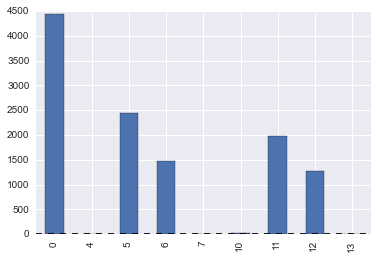

In [40]:
test_period_year = pd.concat([df['period'], df['year']], axis=1)
# result_df = test_period_year.sort(['year'])
grouped_p_y = test_period_year.groupby('period')
# print grouped_p_y.describe()


counts = test_period_year.year.value_counts()

counts = counts.sort_index()
counts.plot(kind="bar" )

In [38]:
grouped_sex = df.groupby(['randid', 'sex'])
sex_count = grouped_sex.sex.value_counts()
# print grouped_sex.count()


group_s =[]
for name, group in grouped_sex:
    
#     print name, group
    group_s.append(name[1])
    
men_count = group_s.count(1)
women_count = group_s.count(2)
print 'men', men_count # all men = 1944
print 'women', women_count # all women = 2490

# sex_count = test_df.sex.where(test_df.hospital == 'cleveland').value_counts()

men 1944
women 2490


In [86]:
def add_str_category_col(df, category):
    pd.concat([df[cont_list], df[category]], axis=1)

In [40]:
def result(diagnosis):
    if not diagnosis:
        return 'GOOD'
    else:
        return 'BAD'

# def gender_diag(sex, diagnosis):
#     if sex == 1:
#         return 'male'
#     else:
#         return 'female'

In [41]:
def plot_pairplot(df, cont_list, category, diagnosis=False):
    print 'Comparing Category: \t%s' % category
    if diagnosis:
        df['result'] = df[category].apply(lambda x: result(x)) + '_' + df['gender']
        category = 'result'
#     print df['result'].values
    sns.pairplot(pd.concat([df[cont_list], df[category]], axis=1), hue=category, palette='dark', diag_kind="kde")


## COMPARING GENDER

Comparing Category: 	gender


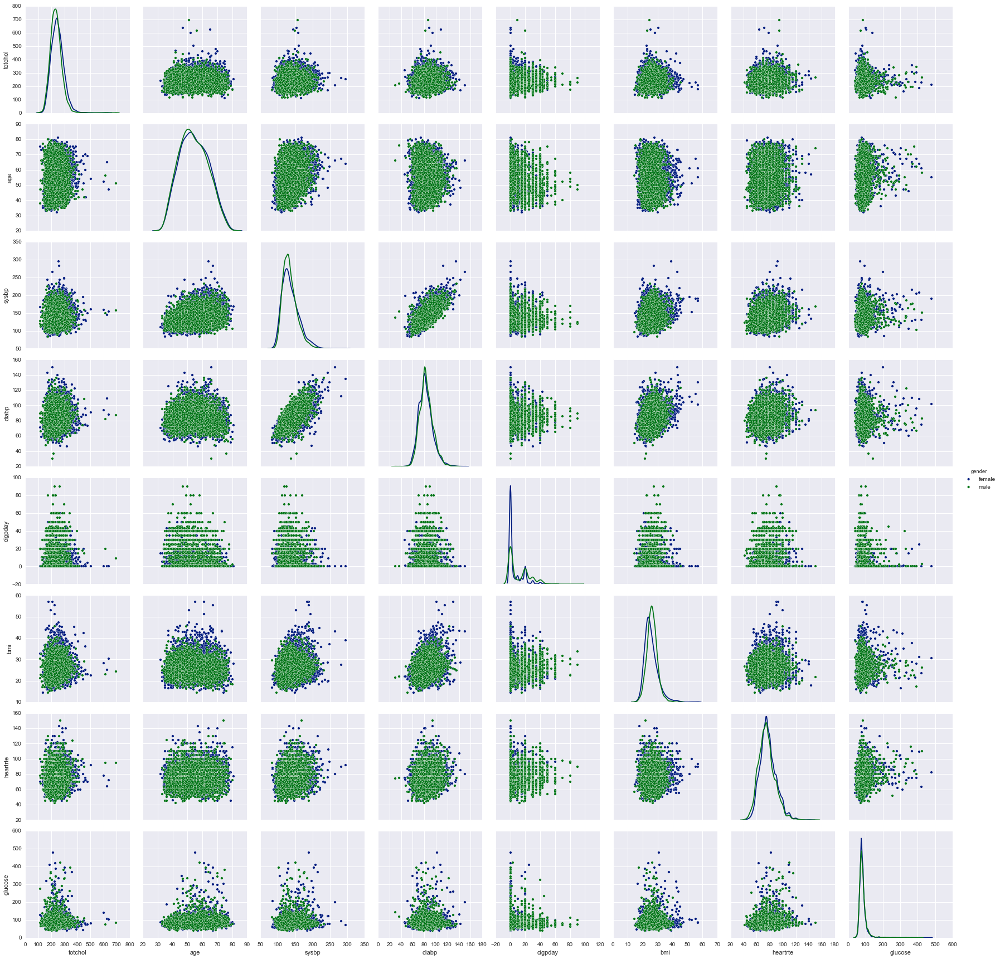

In [429]:
plot_pairplot(test_df, continuous_list[:8], 'gender')

Comparing Category: 	gender


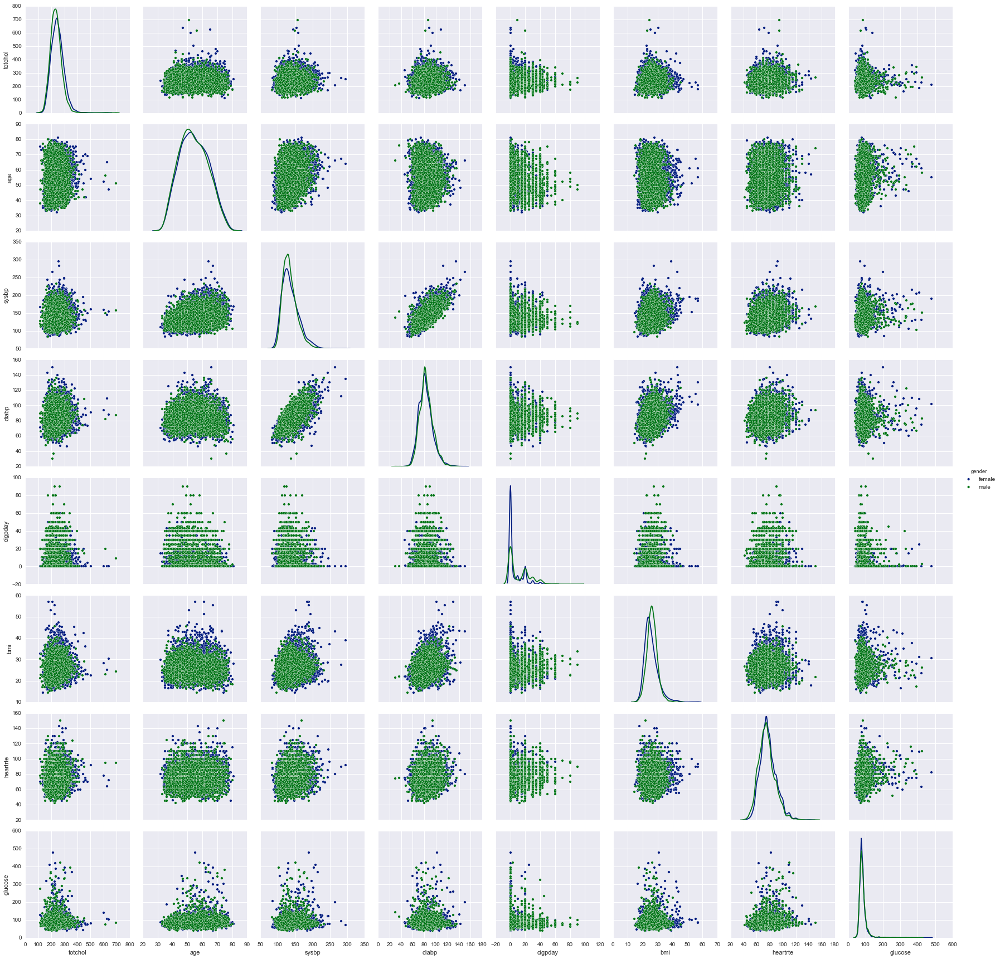

In [44]:
plot_pairplot(dropna_without_chol_split_df, continuous_list[:8], 'gender')

In [ ]:
# sns.pairplot(pd.concat([test_df[continuous_list[:8]], test_df['anychd']], axis=1), hue='anychd')

## COMPARING DIAGNOSIS - DEATH

Comparing Category: 	death


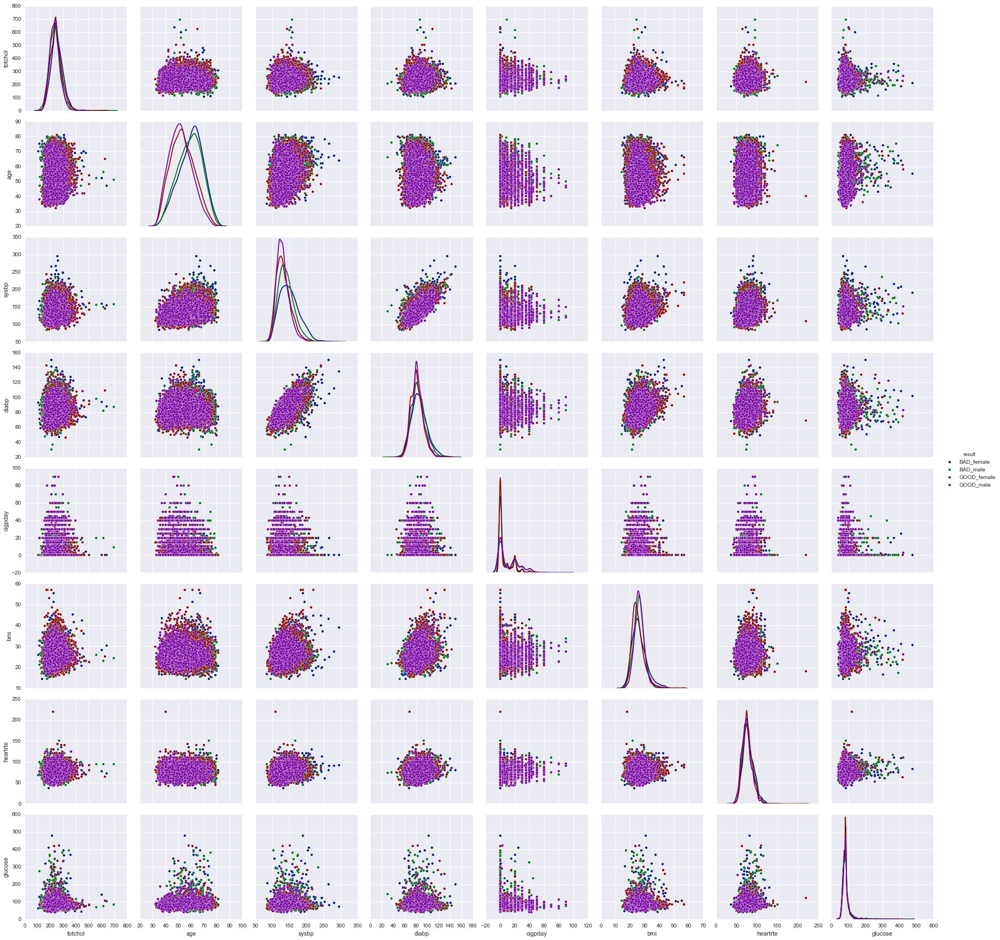

In [138]:
# for cat in diagnosis_list:
#     plot_pairplot(test_df, continuous_list[:8], cat)
i = 0
plot_pairplot(test_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

Comparing Category: 	death


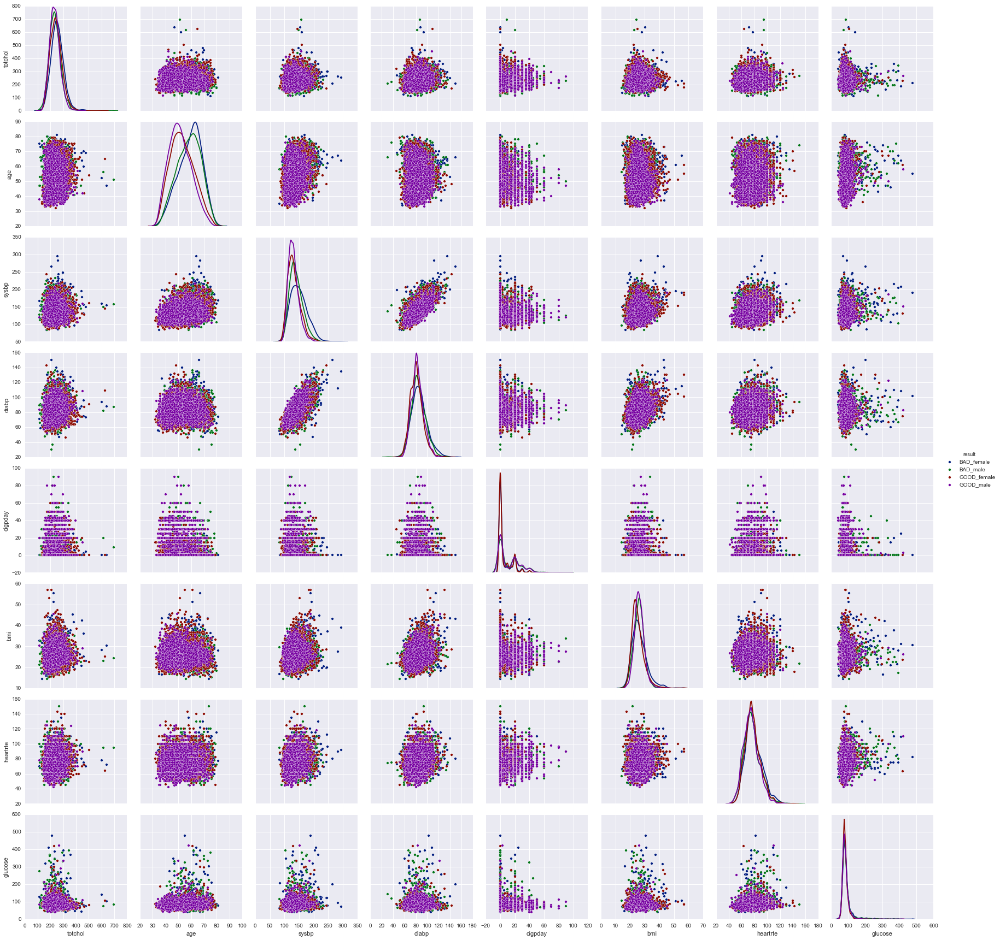

In [45]:
i = 0
plot_pairplot(dropna_without_chol_split_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

## COMPARING DIAGNOSIS - ANGINA

Comparing Category: 	angina


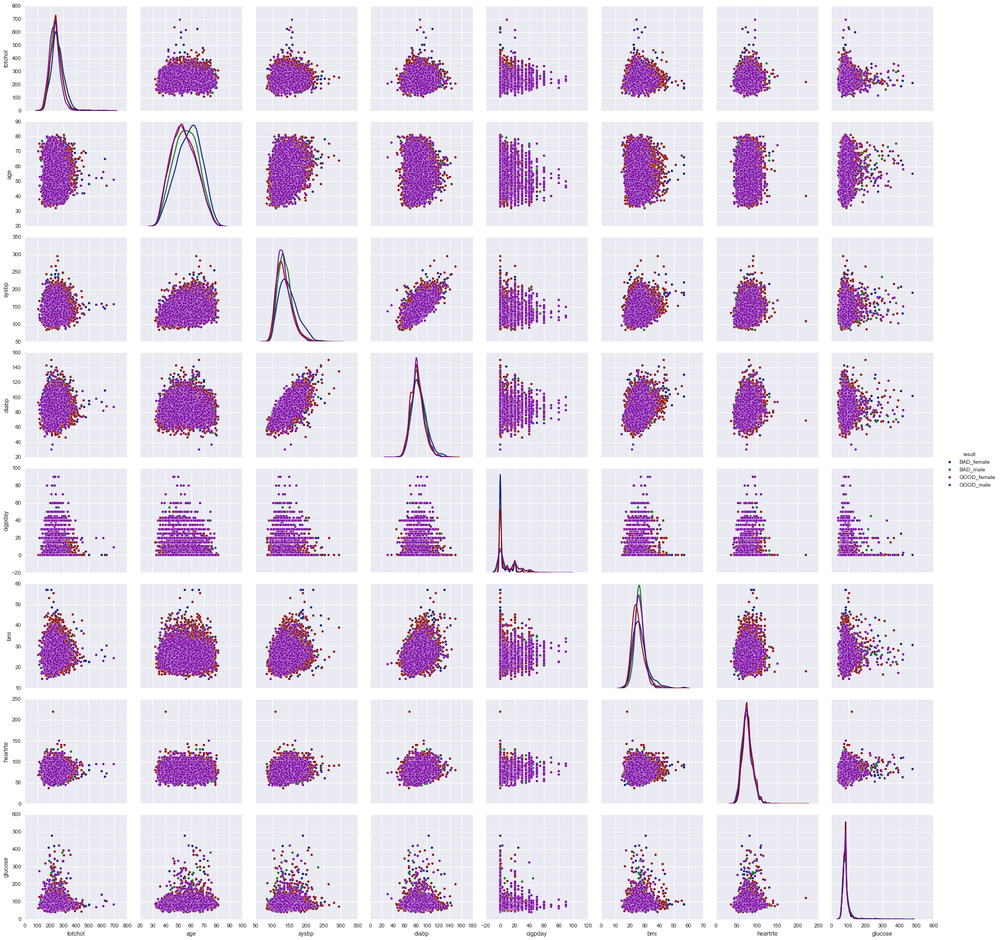

In [139]:
i += 1
plot_pairplot(test_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

Comparing Category: 	angina


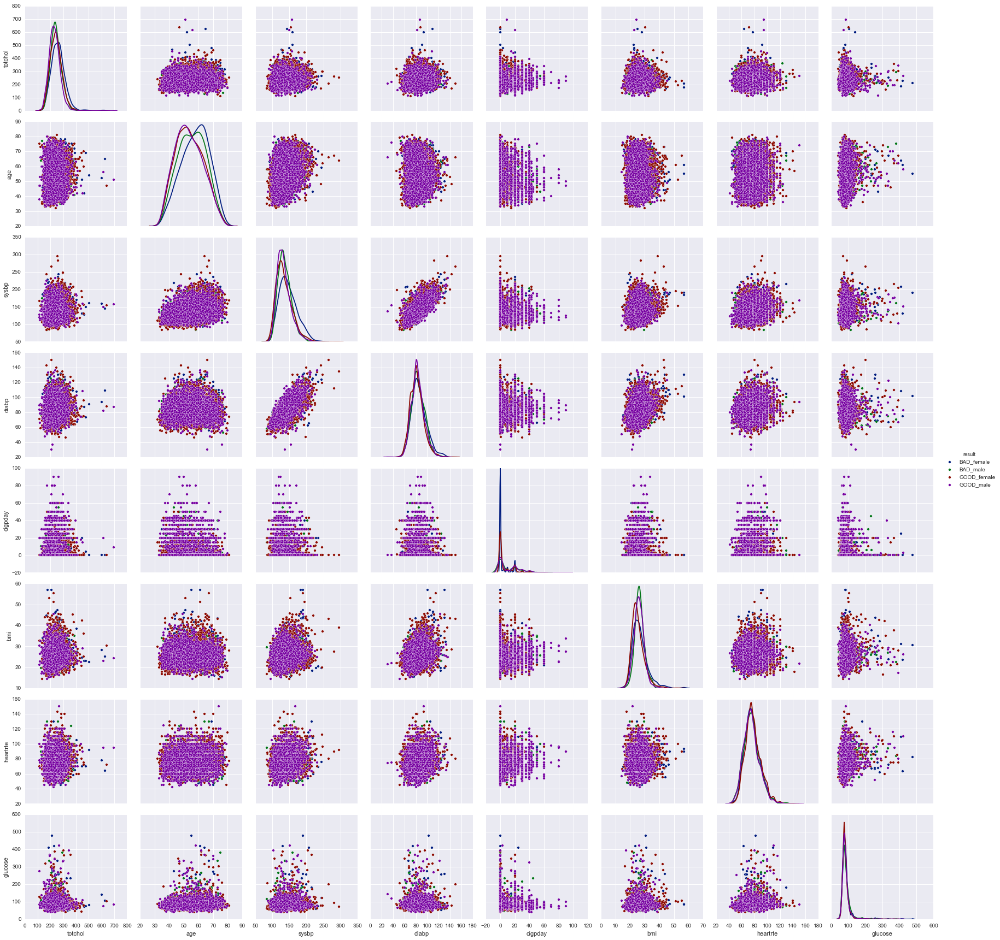

In [46]:
i += 1
plot_pairplot(dropna_without_chol_split_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

## COMPARING CATEGORY: HOSPMI

Comparing Category: 	hospmi


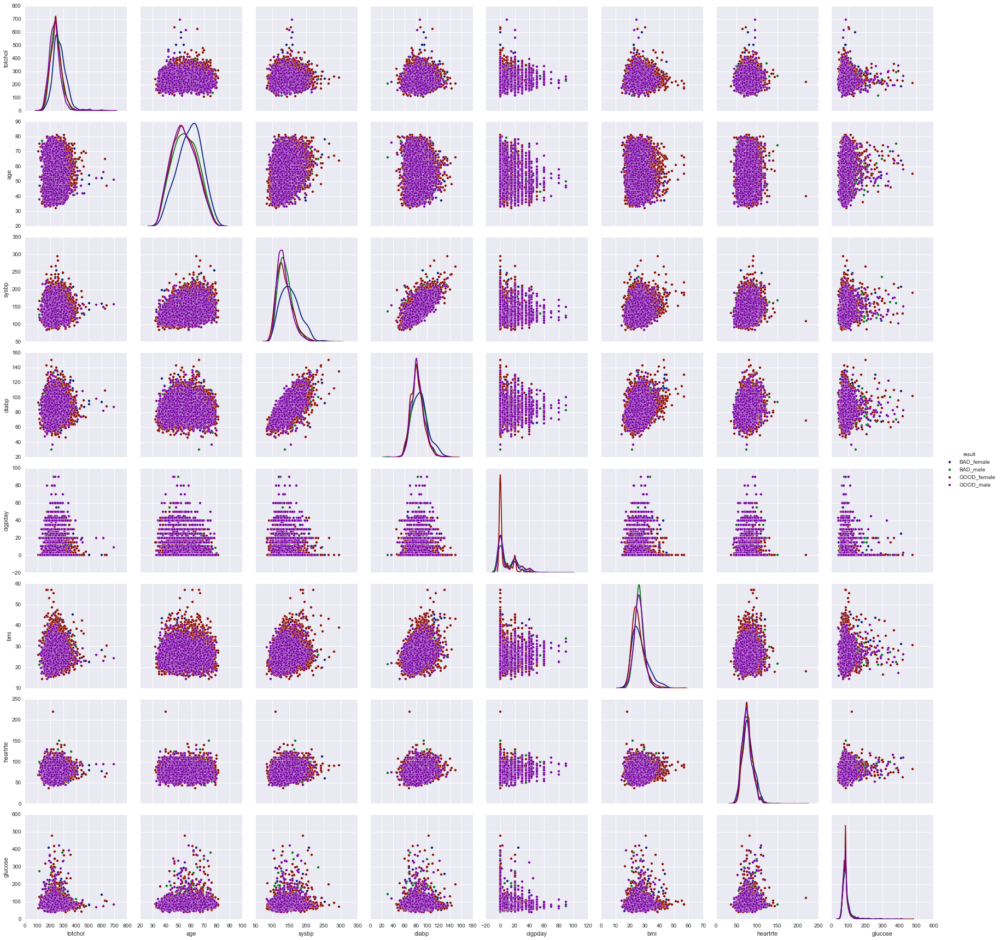

In [140]:
i += 1
plot_pairplot(test_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

Comparing Category: 	hospmi


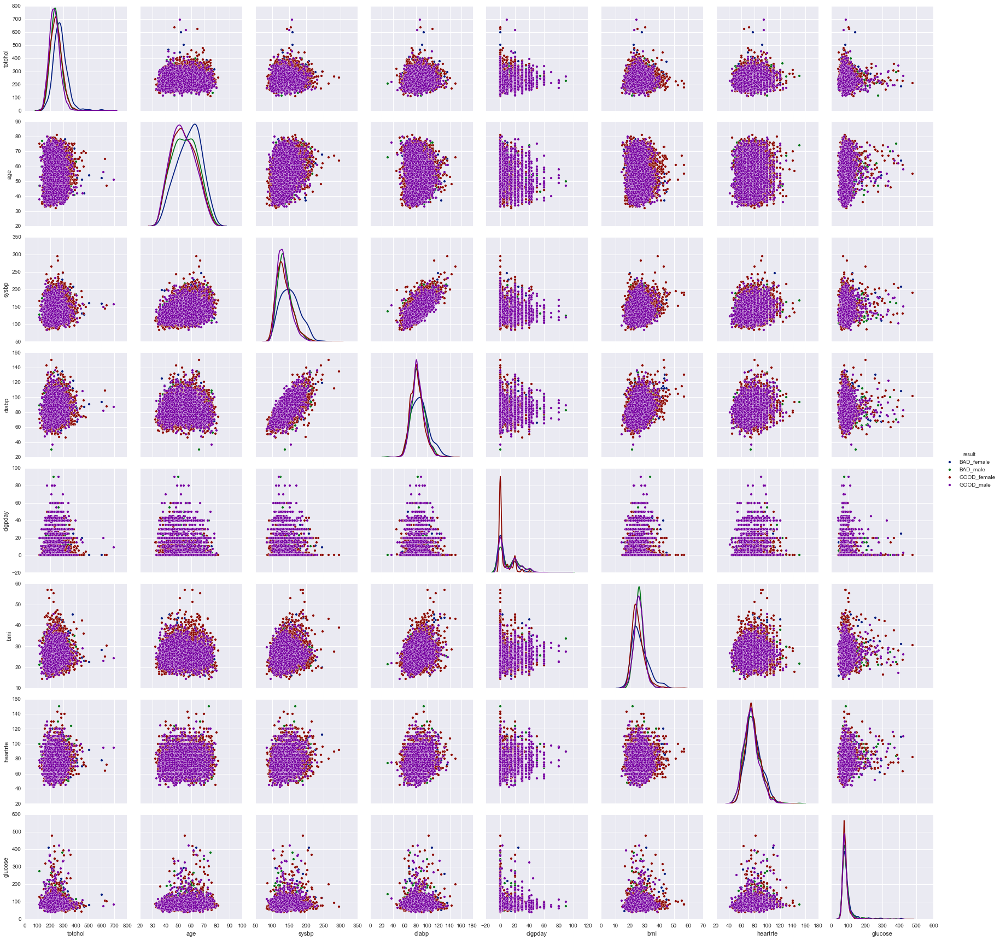

In [47]:
i += 1
plot_pairplot(dropna_without_chol_split_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

## COMPARING CATEGORY: MI_FCHD

Comparing Category: 	mi_fchd


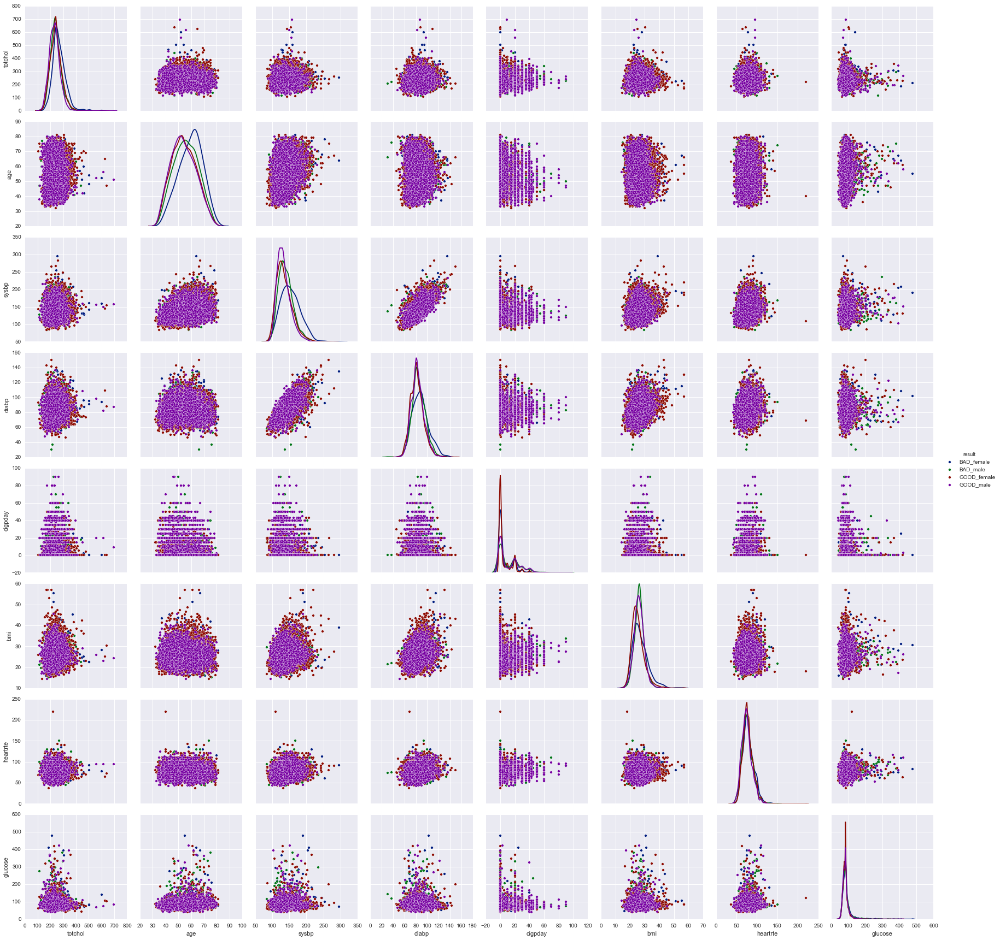

In [141]:
i += 1
plot_pairplot(test_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

Comparing Category: 	mi_fchd


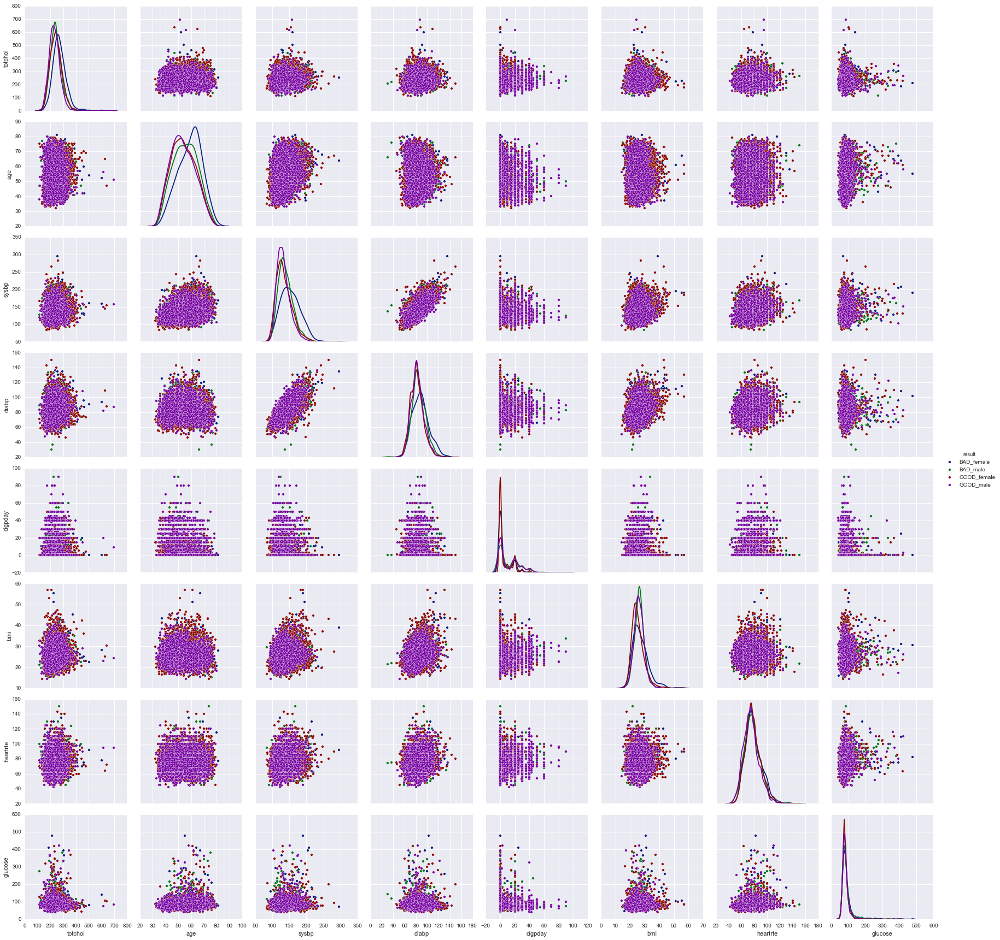

In [48]:
i += 1
plot_pairplot(dropna_without_chol_split_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

## COMPARING CATEGORY: ANYCHD

Comparing Category: 	anychd


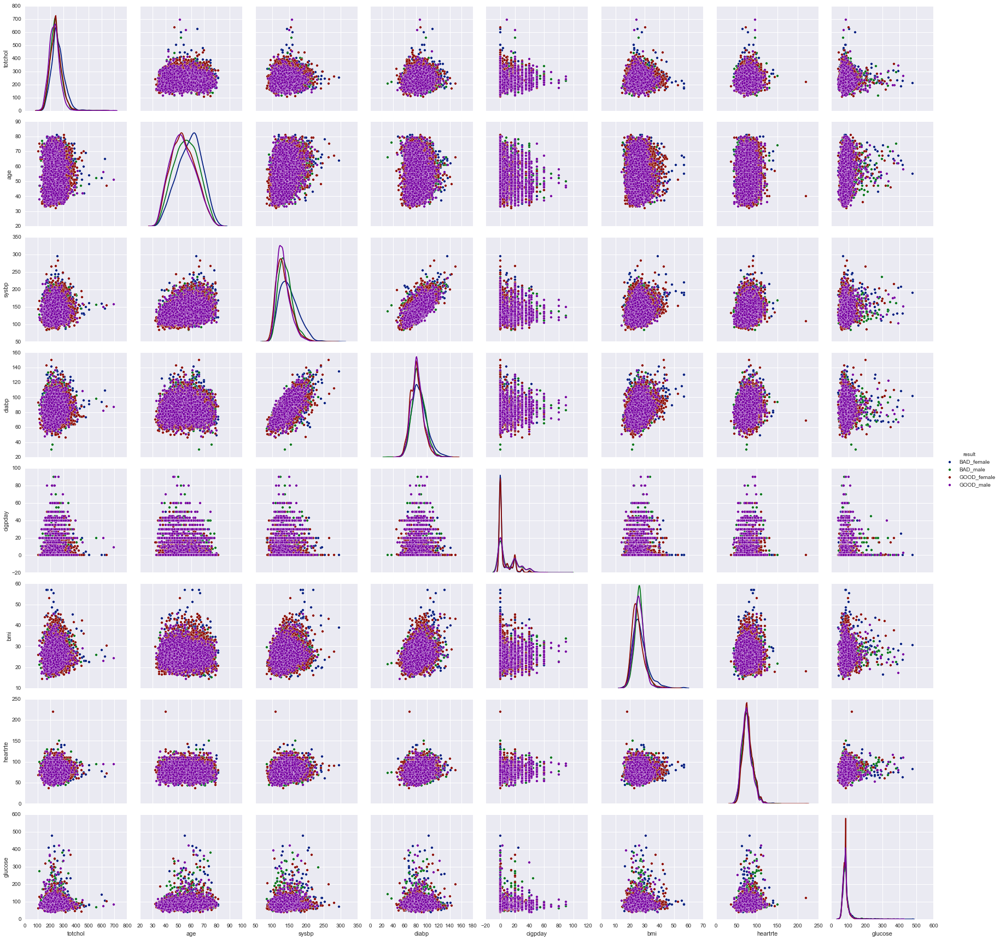

In [142]:
i += 1
plot_pairplot(test_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

Comparing Category: 	anychd


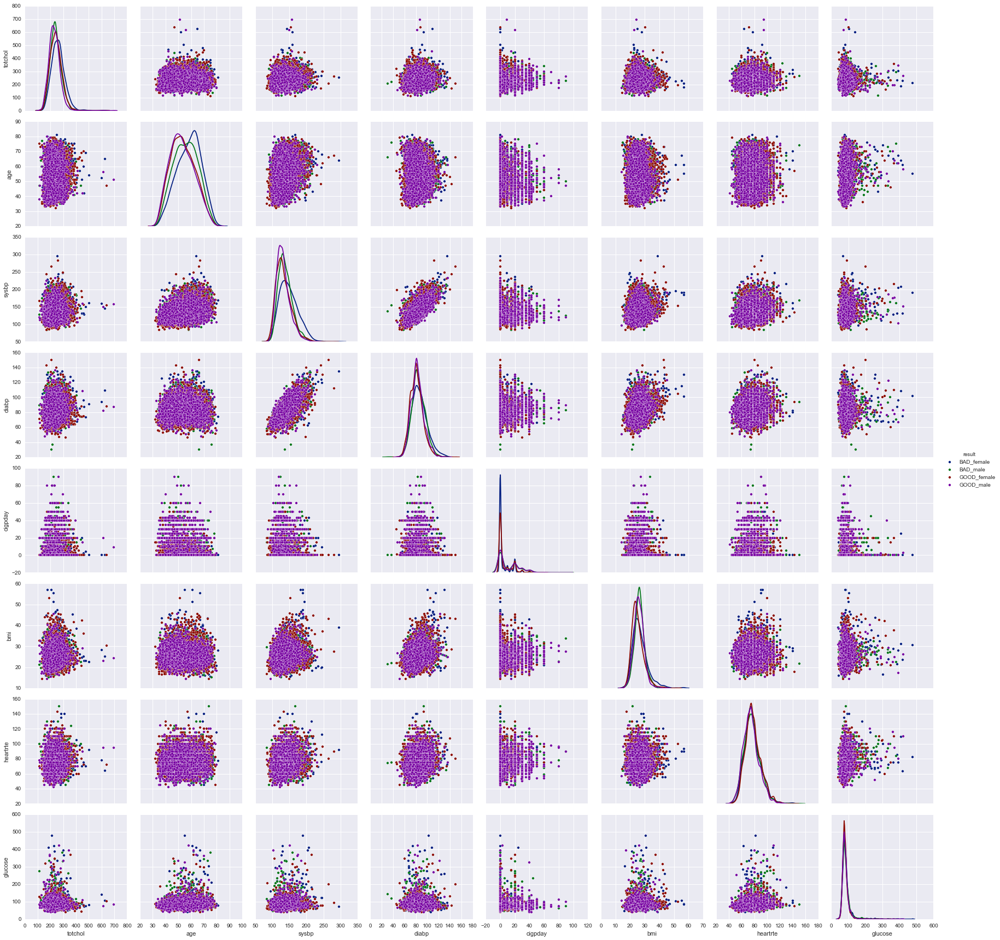

In [49]:
i += 1
plot_pairplot(dropna_without_chol_split_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

## COMPARE CATEGORY: STROKE

Comparing Category: 	stroke


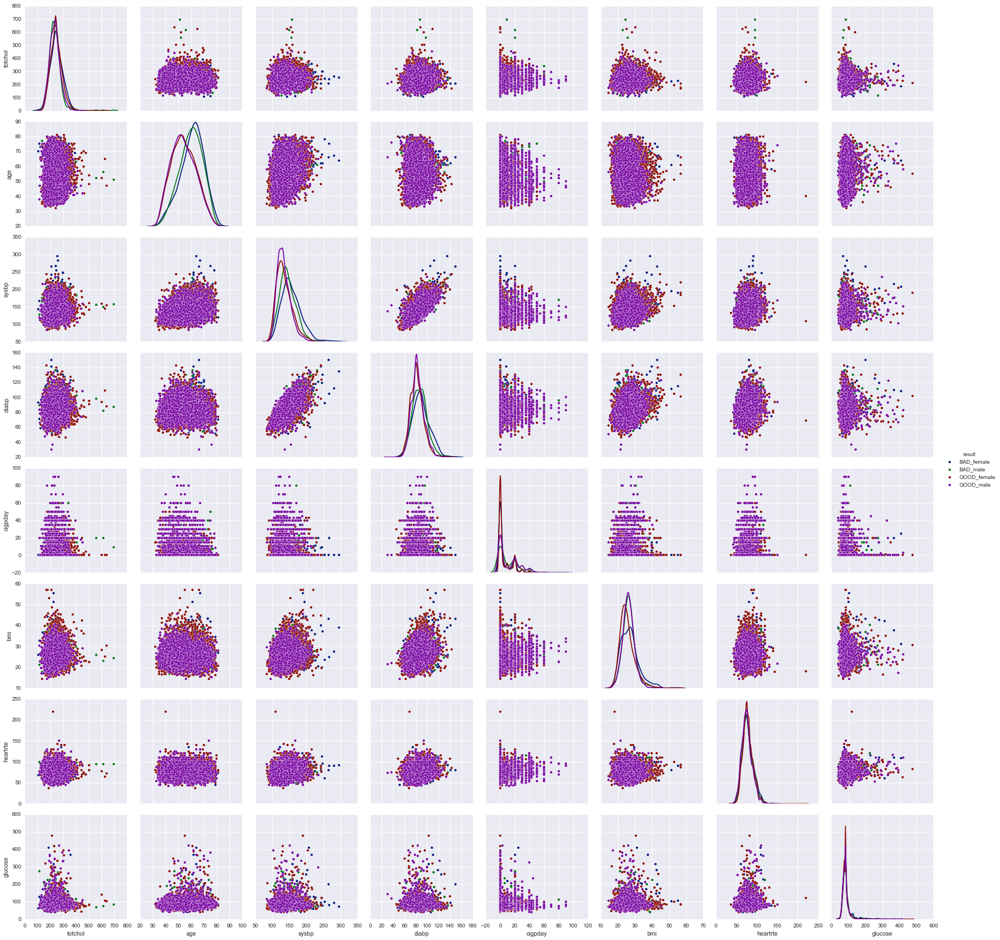

In [143]:
i += 1
plot_pairplot(test_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

Comparing Category: 	stroke


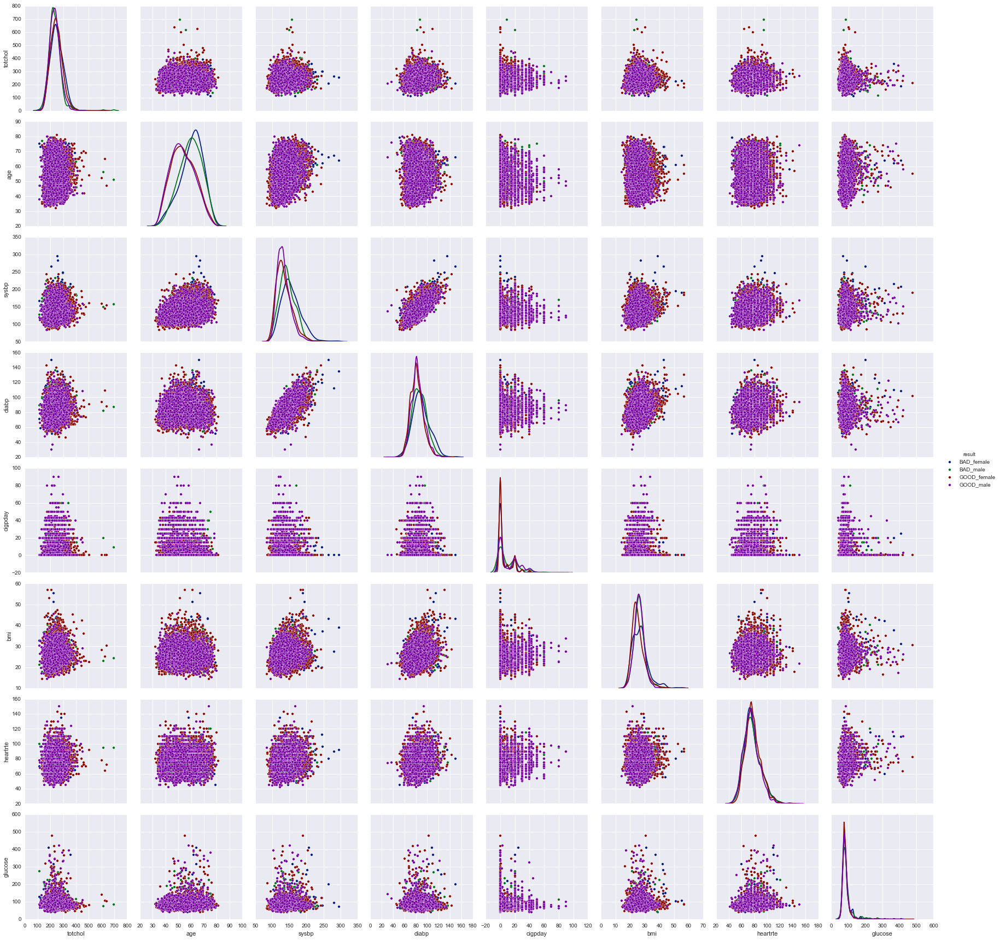

In [50]:
i += 1
plot_pairplot(dropna_without_chol_split_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

## COMPARE CATEGORY: CVD

Comparing Category: 	cvd


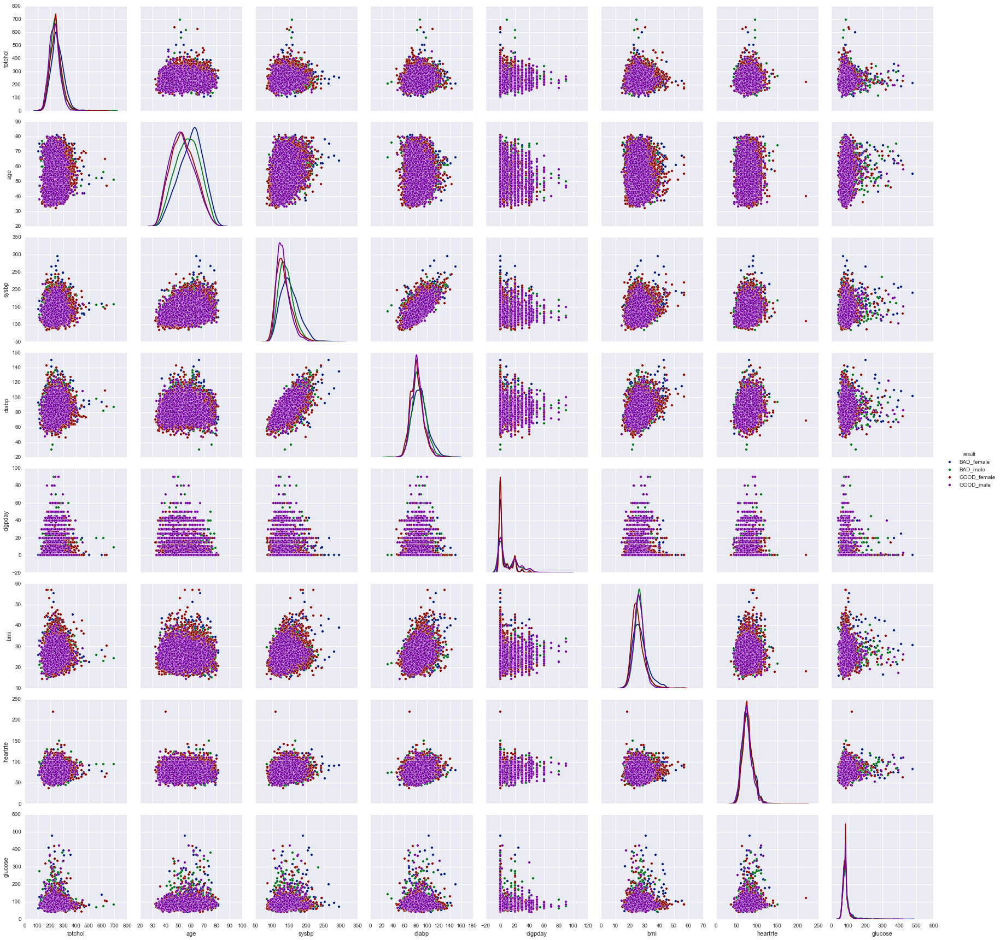

In [144]:
i += 1
plot_pairplot(test_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

Comparing Category: 	cvd


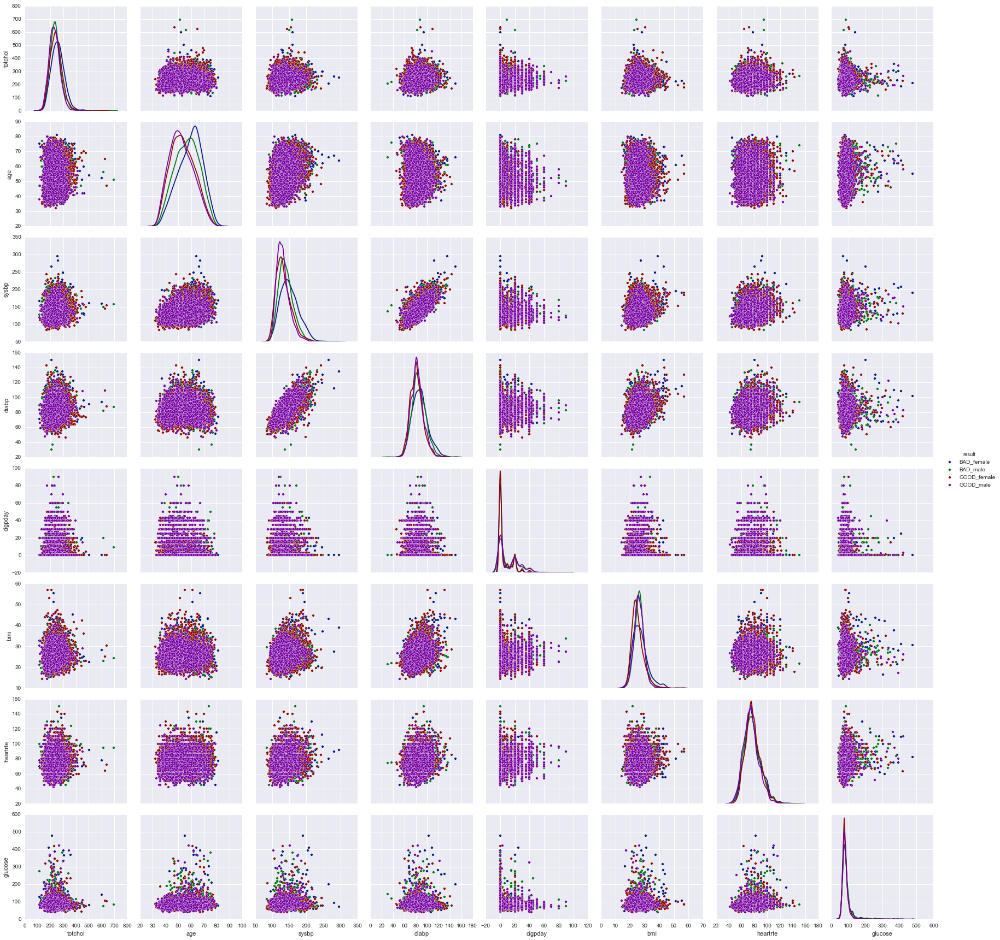

In [51]:
i += 1
plot_pairplot(dropna_without_chol_split_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

## COMPARE CATEGORY: HYPERTEN

Comparing Category: 	hyperten


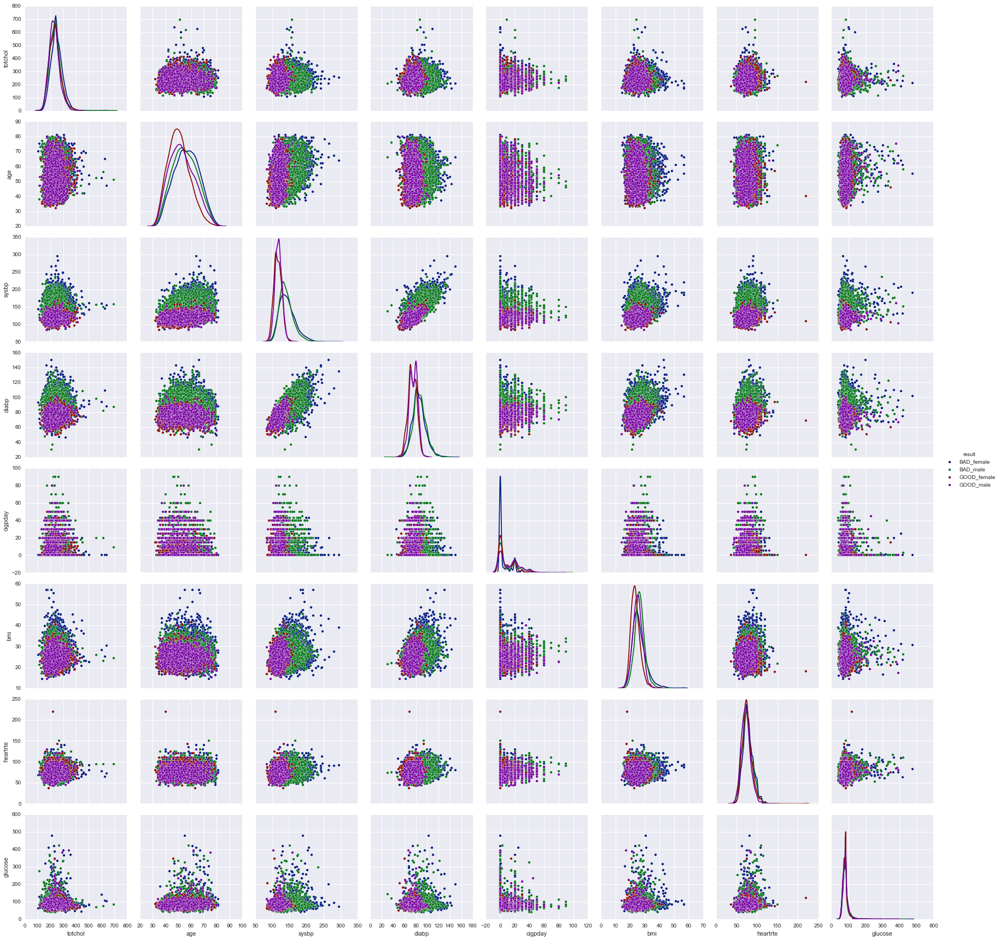

In [145]:
i += 1
plot_pairplot(test_df, continuous_list[:8], diagnosis_list[i], diagnosis=True)

Comparing Category: 	hyperten


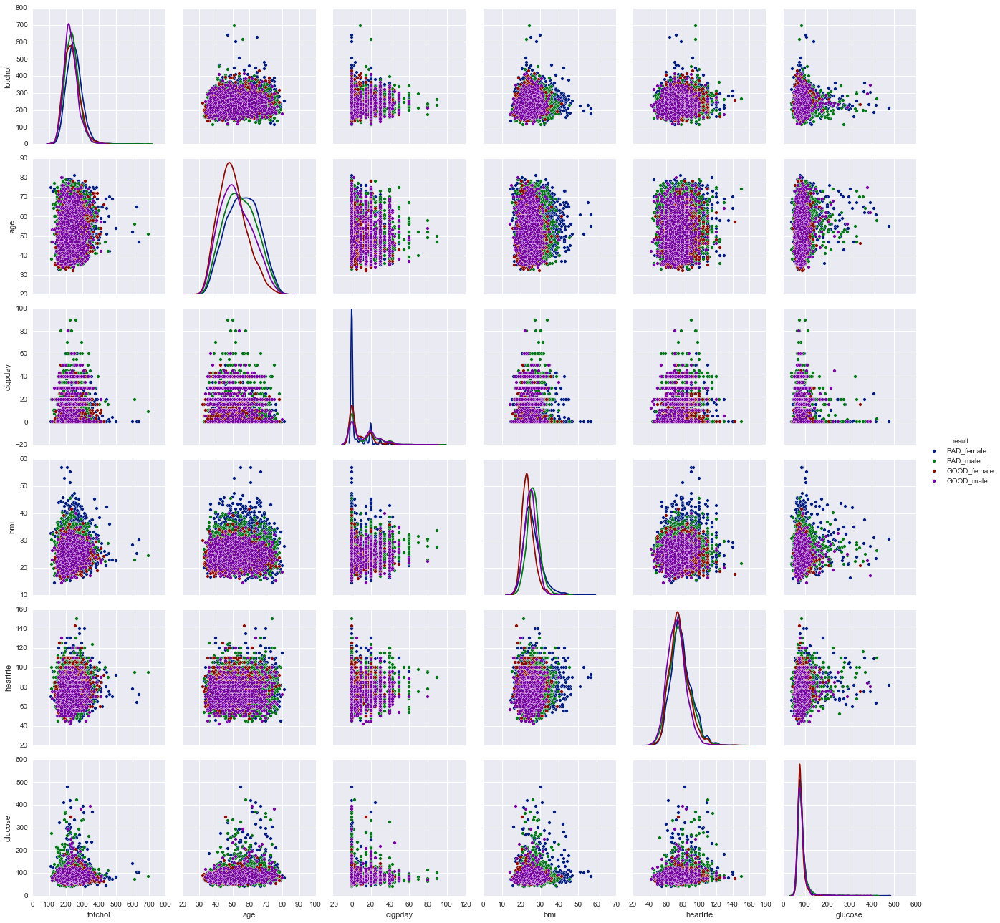

In [59]:
# i += 1

plot_pairplot(dropna_without_chol_split_df, continuous_list[:2]+continuous_list[4:8], diagnosis_list[i], diagnosis=True)

In [58]:
print continuous_list[:8]
print continuous_list[:2]+continuous_list[4:8]

['totchol', 'age', 'sysbp', 'diabp', 'cigpday', 'bmi', 'heartrte', 'glucose']
['totchol', 'age', 'cigpday', 'bmi', 'heartrte', 'glucose']


In [ ]:
Comparing Category: 	death
Comparing Category: 	angina
Comparing Category: 	hospmi
Comparing Category: 	mi_fchd
Comparing Category: 	anychd
Comparing Category: 	stroke
Comparing Category: 	cvd
Comparing Category: 	hyperten

In [687]:
# est1, X_input1, Y_input1 = hazard_model(test_df, 
#                                         'angina', 
#                                         time_intervals[1:])
# est2, X_input2, Y_input2 = hazard_model(test_df, 
#                                         'angina', 
#                                         time_intervals[1:] + time_invariants)

# test_df, time_var_inter  = time_variant_interact(test_df, time_intervals[1:], time_variants[1:])

# est3, X_input3, Y_input3 = hazard_model(test_df, 
#                                         'angina', 
#                                         time_intervals[1:] + time_invariants + time_var_inter)

# log_like_1 = logistic_likelihood_from_model(est1, X_input1, Y_input1)
# log_like_2 = logistic_likelihood_from_model(est2, X_input2, Y_input2)
# log_like_3 = logistic_likelihood_from_model(est3, X_input3, Y_input3)

# # print log_like_1, log_like_2, log_like_3 # number increases (less negative) if more predictive value

# deviance = -2*(log_like_1 - log_like_2)
# deviance2 = -2*(log_like_2 - log_like_3)

# print chisqprob(deviance, 1) # significance of model change: devance diff, degrees of freedom increased (# new variables)
# print chisqprob(deviance2, 14)
# print deviance
# print deviance2